<a href="https://colab.research.google.com/github/MavielS/segmentation-client-e-commerce/blob/master/Modelling.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**FAIRE PRESENTATION DU NOTEBOOK + SOMMAIRE**

Objectifs: <br>
    1. Segmentation client avec description actionnable <br>
    2. Analyse de la stabilité des clusters <br>

In [1]:
%reload_ext autoreload
%autoreload 2

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import plotly.io as pio
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Fichier perso
import exploration as ex

# plt.style.use('fivethirtyeight')
# plt.rcParams['figure.figsize'] = (12, 8)
# plt.rcParams['figure.dpi'] = 100

pd.set_option('plotting.backend', 'plotly')
pd.set_option("display.min_rows", 10)
pd.set_option("display.max_columns", 50)
pd.set_option('display.max_colwidth', None)

# Récupération des données

In [3]:
prefix = './csv_files/'

customers = pd.read_csv(prefix + 'olist_customers_dataset.csv')
geolocation = pd.read_csv(prefix + 'olist_geolocation_dataset.csv', dtype={'geolocation_zip_code_prefix': str})
items = pd.read_csv(prefix + 'olist_order_items_dataset.csv')
payments = pd.read_csv(prefix + 'olist_order_payments_dataset.csv')
reviews = pd.read_csv(prefix + 'olist_order_reviews_dataset.csv')
orders = pd.read_csv(prefix + 'olist_orders_dataset.csv').astype({'order_purchase_timestamp':'datetime64','order_approved_at':'datetime64','order_delivered_carrier_date':'datetime64','order_delivered_customer_date':'datetime64','order_estimated_delivery_date':'datetime64'})
products = pd.read_csv(prefix + 'olist_products_dataset.csv')
sellers = pd.read_csv(prefix + 'olist_sellers_dataset.csv') # Non-pertinent pour l'étude

dict_csv = {'customers':customers, 'geolocation':geolocation, 'items':items, 'payments':payments,
            'reviews':reviews, 'orders':orders, 'products':products, 'sellers':sellers}

In [4]:
data = pd.read_csv(prefix + 'full_data.csv').astype({'order_purchase_timestamp':'datetime64','order_approved_at':'datetime64','order_delivered_carrier_date':'datetime64','order_delivered_customer_date':'datetime64','order_estimated_delivery_date':'datetime64'})

In [4]:
kpi_df = pd.read_csv(prefix + 'kpi.csv')

# Methode analytique: RFM

La segmentation RFM permet de cibler les offres, d'établir des segments basés sur la valeur des clients et de prévenir l'attrition en identifiant des segments à risque. <br>
Elle se base sur 3 composantes: <br>
- **Récence**: Quand était le dernier achat ? <br>
- **Fréquence**: Cb de fois le client a-t-il fait un achat durant cette période donnée ? <br>
- **Montant**: Moyenne des dépenses du client <br>

Je créé les variables total_price et total_freight_price correspondant aux prix et fdp totaux pour une commande.

## Modélisation

### Changement nom de variables

In [25]:
rfm_final = kpi_df[['recence', 'total_commands', 'customer_mean_total_expenses', 'customer_unique_id']].rename({'total_commands':'frequence','customer_mean_total_expenses':'montant'}, axis=1)
rfm_final.set_index('customer_unique_id', inplace=True)

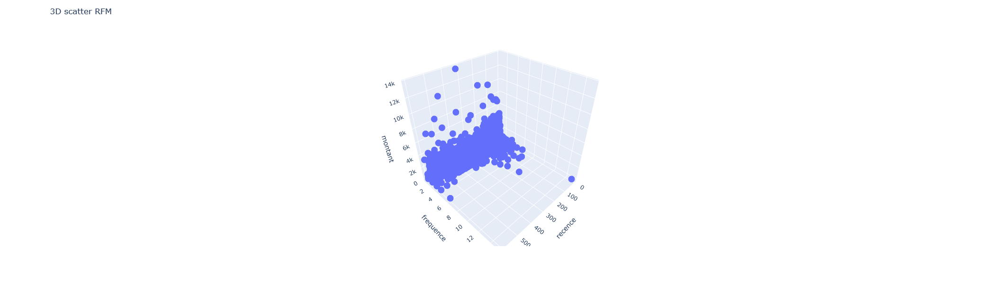

In [15]:
fig = px.scatter_3d(rfm_final, x='recence', y='frequence', z='montant')
fig.update_layout(dict1={'title':'3D scatter RFM', 'width':600, 'height':600})
fig.show()

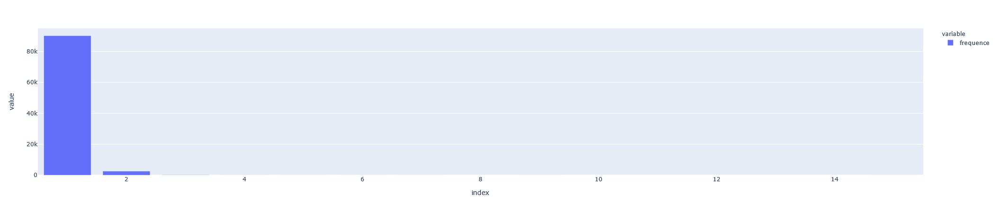

In [16]:
px.bar(rfm_final.frequence.value_counts())

<font color='red'> <b>Observations</b></font> <br>

- Les variations de la dimension fréquence sont très faibles (la très grande majorité des clients n'ayant commandé qu'une unique fois)

Afin de déterminer le score de chacun des clients, il faut maintenant que je définisse les règles de scoring. <br>
Pour cela, je trie par puis découpe en 4 chacune de mes variables. <br> 
Pour chaque RFM de chaque client, le quartile auquel appartient le client défini un score <br>
<br>
Exemples: 
- Le client achète avec les montants les plus élevés --> M=1
- Le client a acheté il y a peu --> R=1

### Décomposition en quartile

In [27]:
def rfm_quartile(rfm: pd.DataFrame, col: str):

    mini = rfm[col].min(); q1 = np.quantile(rfm[col], 0.25)
    q2 = np.quantile(rfm[col], 0.5); q3 = np.quantile(rfm[col], 0.75)

    return {'mini':mini, 'q1':q1, 'q2':q2, 'q3':q3}

In [28]:
q_recence = rfm_quartile(rfm_final, col='recence')
q_frequence = rfm_quartile(rfm_final, col='frequence')
q_montant = rfm_quartile(rfm_final, col='montant')

In [29]:
def score_recence(value):
    if value <= q_recence['q1']:
        return 1
    elif value > q_recence['q1'] and value <= q_recence['q2']:
        return 2
    elif value > q_recence['q2'] and value <= q_recence['q3']:
        return 3
    else:
        return 4

def score_frequence(value):
    if value <= q_frequence['q1']:
        return 4
    elif value > q_frequence['q1'] and value <= q_frequence['q2']:
        return 3
    elif value > q_frequence['q2'] and value <= q_frequence['q3']:
        return 2
    else:
        return 1
    
def score_montant(value):
    if value <= q_montant['q1']:
        return 4
    elif value > q_montant['q1'] and value <= q_montant['q2']:
        return 3
    elif value > q_montant['q2'] and value <= q_montant['q3']:
        return 2
    else:
        return 1

In [30]:
r_score = rfm_final.recence.apply(func=score_recence)
f_score = rfm_final.frequence.apply(func=score_frequence)
m_score = rfm_final.montant.apply(func=score_montant)

rfm_score = pd.DataFrame({'r':r_score,'f':f_score,'m':m_score})

In [31]:
rfm_final['score'] = r_score.astype('str') + '-' + f_score.astype('str') + '-' + m_score.astype('str')

rfm_final

,recence,frequence,montant,score
customer_unique_id,,,,
b1a1199364a4a7fe27c4486ab63f550d,124,1,18.30,2-4-4
4b86049cb99e4aa774031daa9cd18f18,207,1,265.99,2-4-1
f63805d9c7edb84d92413af34b86a39c,48,1,87.62,1-4-3
619e926d09b26efbd5180368b1ddc874,23,1,121.84,1-4-2
ad353b4fb0e294adc4eda48af73e68a6,137,1,46.19,2-4-4
...,...,...,...,...
ef33488f0db8c02f881cb40ec9af5d69,228,1,139.39,3-4-2
1fd97aeef909db302af3962152746e9e,309,1,111.64,3-4-2
4d1bbadcfd9bdc738e54599627870319,234,1,92.02,3-4-3


Je cherche à savoir quelles combinaisons sont les plus présentes ici.

In [32]:
(rfm_final.score.value_counts()/rfm_final.shape[0])*100

4-4-3    6.292894
2-4-4    6.260623
1-4-2    6.248790
4-4-4    6.215443
3-4-3    6.190702
2-4-2    6.186399
2-4-1    6.097115
4-4-1    6.080979
1-4-4    6.073449
1-4-1    6.072374
3-4-4    5.997074
3-4-2    5.968030
3-4-1    5.951894
2-4-3    5.850778
1-4-3    5.810977
4-4-2    5.707709
1-1-2    0.261397
2-1-3    0.252791
2-1-2    0.234504
1-1-3    0.233429
1-1-1    0.217293
2-1-1    0.217293
3-1-2    0.216217
3-1-1    0.191476
3-1-3    0.187173
4-1-3    0.175340
4-1-1    0.172113
4-1-2    0.169962
1-1-4    0.121555
3-1-4    0.121555
2-1-4    0.118328
4-1-4    0.104344
Name: score, dtype: float64

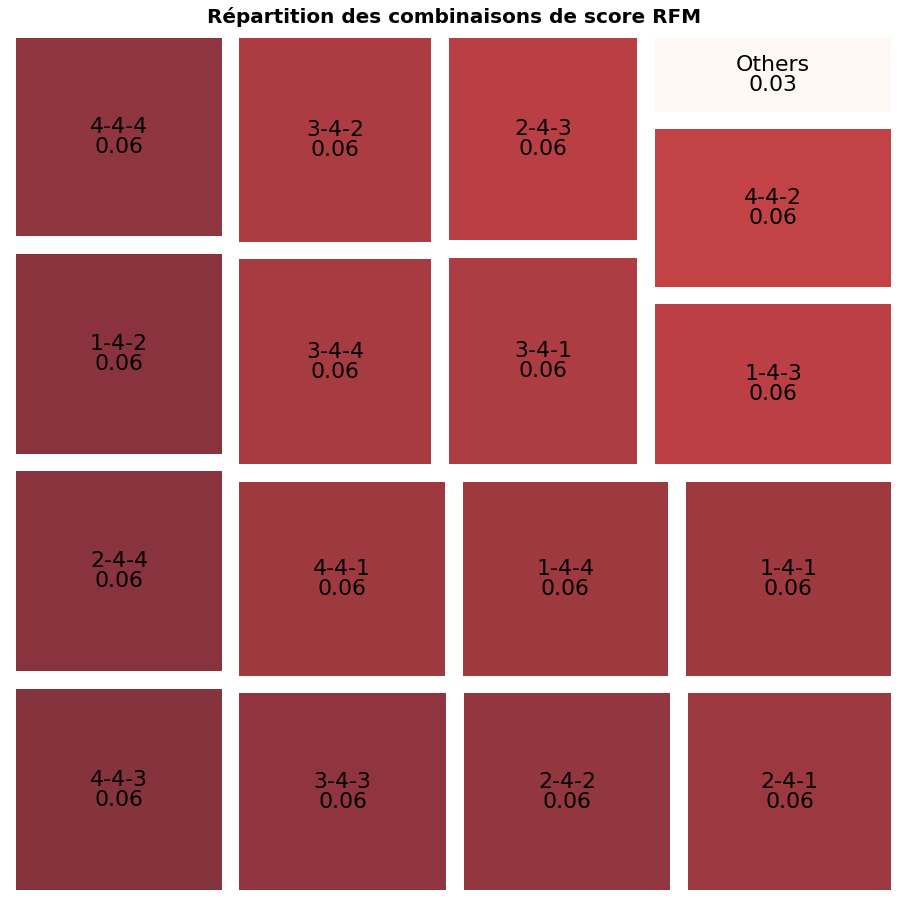

In [33]:
ex.squarify_value_counts(rfm_final.score,17, title='Répartition des combinaisons de score RFM')

<font color='red'> <b>Observations</b></font> <br>

- Je note tout d'abord que toutes les combinaisons possibles ne sont pas présentes (Il devrait y avoir 4x4x4=64 catégories)
- J'ai 16 catégories qui regroupent chacune environ 6% des clients, le reste représentant 3% dez clients

In [34]:
rfm_2 = rfm_final.copy()

rfm_2['has_reordered'] = rfm_2.frequence.apply(func=lambda x: 1 if x>1 else 0)

rfm_2.drop(['frequence', 'score'], axis='columns', inplace=True)

In [35]:
rfm_2.groupby('has_reordered').sum()['montant']/rfm_2['montant'].sum()

has_reordered
0    0.970688
1    0.029312
Name: montant, dtype: float64

In [36]:
rfm_2.has_reordered.value_counts()/rfm_2.shape[0]

0    0.970052
1    0.029948
Name: has_reordered, dtype: float64

<font color='red'> <b>Observations</b></font> <br>

- Les clients ayant commandé plus d'une fois représentent 3% des clients et représentent 3% du CA. Ce sont donc des clients aussi rentable que des clients 'one-shot'.

### Catégorisation

En fonction des scores, je peux attribuer une catégorie aux clients. <br>
Pour cela je suis une catégorisation présente dans la littérature.

In [37]:
customer_segment = pd.DataFrame()
segment = ["Champions", "Potentiels champions", "Nouveaux clients", "A ne pas perdre", "Seconde main", "Dormants économes", "Others"]

# rfm = ["1-1-1", "1-X-X", "X-X-1", "3-1-1", "4-1-1", "4-4-4", "Others"]

description = ["Ont acheté le plus récemment et le plus souvent avec les plus gros montants.",
               "Clients récents, avec une bonne fréquence d'achat et qui dépensent beaucoup",
               "Clients ayant acheté récemment",
               "Clients qui achetaient  avec des montants importants mais qui n'ont pas acheté récemment",
               "Clients avec des moyens montants qui n'ont acheté récemment",
               "Clients qui achetaient peu fréquemment, avec de faibles montants et qui n'ont pas acheté depuis longtemps",
               ""
              ]
action = ["Tout faire pour les conserver. Les récompenser pour leur engagement.",
         "Proposez des programmes de fidélité, recommander des produits similaires et les pousser vers la catégorie Champions",
         "Commencez à construire une relation avec ces clients en leur apportant un SAV compétent et des offres spéciales pertinentes pour augmenter leurs visites.",
         "Envoyez des campagnes personnelles agressives, des promotions pertinentes, des enquêtes pour savoir ce qui ne va pas.",
         "Envoyez des campagnes personnelles et des promotions pertinentes",
         "Ne pas perdre trop de temps et de ressources sur ces clients",
         "Si trop important, ajuster la segmentation"
        ]

champions = ['1-1-1']
pot_champions = ['2-1-1',  '1-1-2', '2-1-2'] # '1-2-1', '2-2-1', '2-2-2' non présents 
nvx_clients = [ '1-1-3', '1-1-4', '1-4-1', '1-4-2', '1-4-3', '1-4-4'] # "1-2-1", "1-3-1", "1-2-2", "1-2-3", "1-2-4", "1-3-2", "1-3-3", "1-3-4" non présents / "1-1-1" = Best_Customers / "1-1-2" = nvx_clients
pas_perdre = ['3-1-1', '4-1-1', '3-1-2', '4-1-2', '4-4-2', '4-4-1']
seconde_main = [ '2-1-3', '2-1-4', '2-4-1', '2-4-2', '2-4-3', '2-4-4']
dormants_eco = ['4-4-4', '4-4-3']


nb_clients = []

nb_clients.append(rfm_final.score.value_counts().loc[champions].sum())
nb_clients.append(rfm_final.score.value_counts().loc[pot_champions].sum())
nb_clients.append(rfm_final.score.value_counts().loc[nvx_clients].sum())
nb_clients.append(rfm_final.score.value_counts().loc[pas_perdre].sum())
nb_clients.append(rfm_final.score.value_counts().loc[seconde_main].sum())
nb_clients.append(rfm_final.score.value_counts().loc[dormants_eco].sum())
nb_clients.append((rfm_final.score.value_counts()).sum() - sum(nb_clients)) # Others

CA = []
CA_total = rfm_final.groupby('score').sum()['montant'].sum()

CA.append(rfm_final.groupby('score').sum()['montant'].loc[champions].sum())
CA.append(rfm_final.groupby('score').sum()['montant'].loc[pot_champions].sum())
CA.append(rfm_final.groupby('score').sum()['montant'].loc[nvx_clients].sum())
CA.append(rfm_final.groupby('score').sum()['montant'].loc[pas_perdre].sum())
CA.append(rfm_final.groupby('score').sum()['montant'].loc[seconde_main].sum())
CA.append(rfm_final.groupby('score').sum()['montant'].loc[dormants_eco].sum())
CA.append(CA_total - sum(CA))



# customer_segment["rfm"] = rfm
customer_segment['segments clients'] = segment
customer_segment['nb_clients'] = nb_clients
customer_segment['nb_clients_perc'] = (nb_clients/sum(nb_clients) )*100
customer_segment['CA'] = CA
customer_segment['CA_perc'] = CA/CA_total * 100 
customer_segment['description'] = description
customer_segment['action'] = action

customer_segment

,segments clients,nb_clients,nb_clients_perc,CA,CA_perc,description,action
0,Champions,202,0.217293,6.820227e+04,0.436782,Ont acheté le plus récemment et le plus souvent avec les plus gros montants.,Tout faire pour les conserver. Les récompenser pour leur engagement.
1,Potentiels champions,663,0.713195,1.291837e+05,0.827319,"Clients récents, avec une bonne fréquence d'achat et qui dépensent beaucoup","Proposez des programmes de fidélité, recommander des produits similaires et les pousser vers la catégorie Champions"
2,Nouveaux clients,22832,24.560573,3.878249e+06,24.837119,Clients ayant acheté récemment,Commencez à construire une relation avec ces clients en leur apportant un SAV compétent et des offres spéciales pertinentes pour augmenter leurs visites.
3,A ne pas perdre,11656,12.538457,3.288133e+06,21.057888,Clients qui achetaient avec des montants importants mais qui n'ont pas acheté récemment,"Envoyez des campagnes personnelles agressives, des promotions pertinentes, des enquêtes pour savoir ce qui ne va pas."
4,Seconde main,23023,24.766033,3.769514e+06,24.140752,Clients avec des moyens montants qui n'ont acheté récemment,Envoyez des campagnes personnelles et des promotions pertinentes
5,Dormants économes,11628,12.508337,7.434177e+05,4.761002,"Clients qui achetaient peu fréquemment, avec de faibles montants et qui n'ont pas acheté depuis longtemps",Ne pas perdre trop de temps et de ressources sur ces clients
6,Others,22958,24.696112,3.738032e+06,23.939138,,"Si trop important, ajuster la segmentation"


In [38]:
print('Table de contingence Recence x Frequence')
pd.crosstab(rfm_score.r,rfm_score.f)

Table de contingence Recence x Frequence


f,1,4
r,,
1,775,22502
2,765,22678
3,666,22411
4,578,22587


In [39]:
print('Table de contingence Recence x Montant')
pd.crosstab(rfm_score.r,rfm_score.m)

Table de contingence Recence x Montant


m,1,2,3,4
r,,,,
1,5847,6052,5619,5759
2,5870,5969,5674,5930
3,5711,5749,5929,5688
4,5813,5464,6013,5875


In [40]:
print('Table de contingence Montant x Frequence')
pd.crosstab(rfm_score.m,rfm_score.f)

Table de contingence Montant x Frequence


f,1,4
m,,
1,742,22499
2,820,22414
3,789,22446
4,433,22819


In [41]:
q_frequence

{'mini': 1, 'q1': 1.0, 'q2': 1.0, 'q3': 1.0}

<font color='red'> <b>Observations</b></font> <br>

- Le fait que ce dataset ne contienne 97% de clients ayant acheté une fois rend peu pertinent le score F dans la séparation en groupe. Je n'ai pas de score F = {2;3}

La méthode de scoring en divisant par quartile s'avère ici peu pertinente car il y a très peu de variations sur ma variable f_score. <br>
On peut même étendre cela à la méthode RFM qui est une modélisation analytique qui s'avère, dans notre cas, peu pertinente: une des (seulement) 3 variables ne nous permet pas de séparer nos clients ! <br>
Le RFM est une approche intéréssante car les clusters formés sont très compréhensibles, cependant dans notre cas, ils sont aussi biaisés car subjectifs (je les définis à la main). <br>

# Méthode automatique (K-means)

Requis sur mes données d'entrées:
- Variables quantitatives
- Pas de bruit ou d'outliers
- Distribution symétrique (Faible skewness)
- Variables sur la même échelle (Scaling)
- Pas de corrélation inter-variables

## Selection A: RFM features

Je fais un premier essai avec le dataset RFM.

In [44]:
seg_a_df = rfm_final.drop('score', axis=1)

Je cherche à observer la symétrie de mes colonnes

Nb de bins optimal estimé: 22


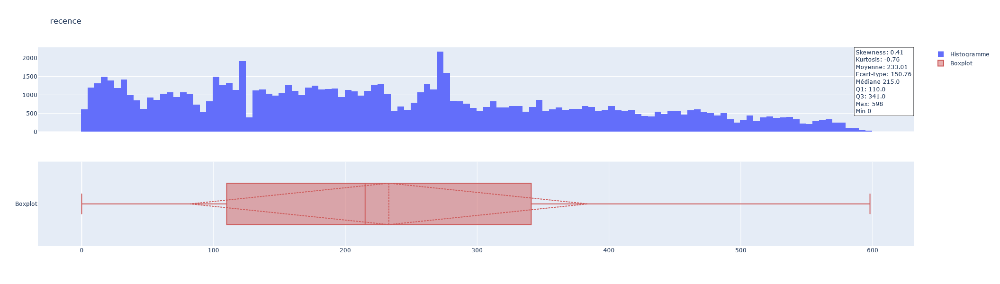

Nb de bins optimal estimé: 8


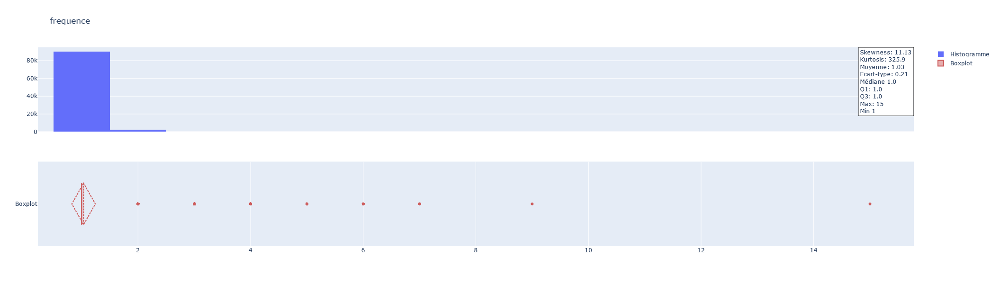

Nb de bins optimal estimé: 35


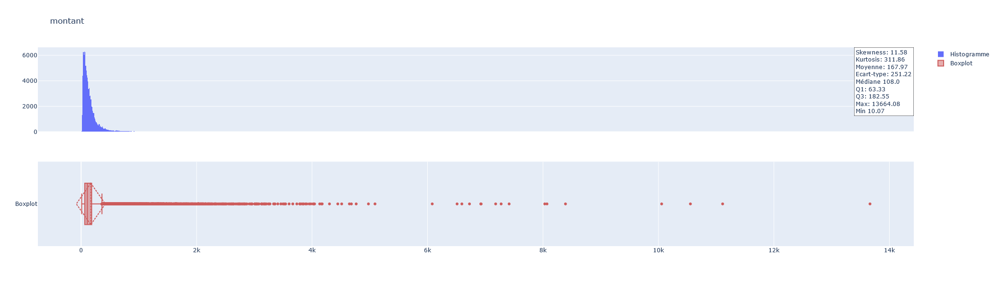

In [45]:
for col in seg_a_df.columns:
    ex.mesure_forme_col(seg_a_df[col], title=col)

<font color='red'> <b>Observations</b></font> <br>

- Fréquence et montant sont fortement asymétriques

En utilisant ces variables, certains clients vont avoir un impact trop fort sur nos centroïdes.

10644 lignes éliminées.
Nb de bins optimal estimé: 22


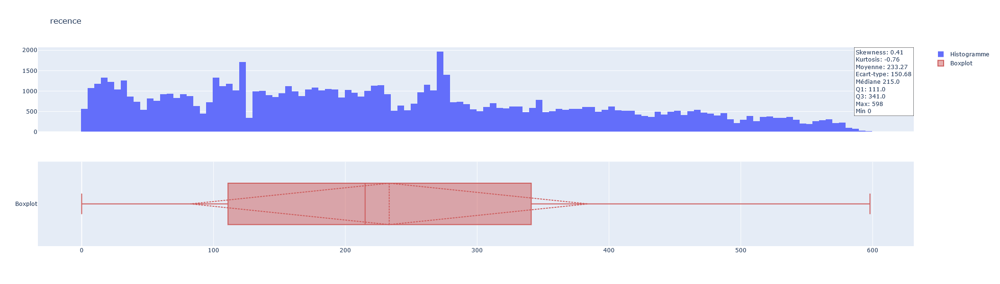

Nb de bins optimal estimé: 1


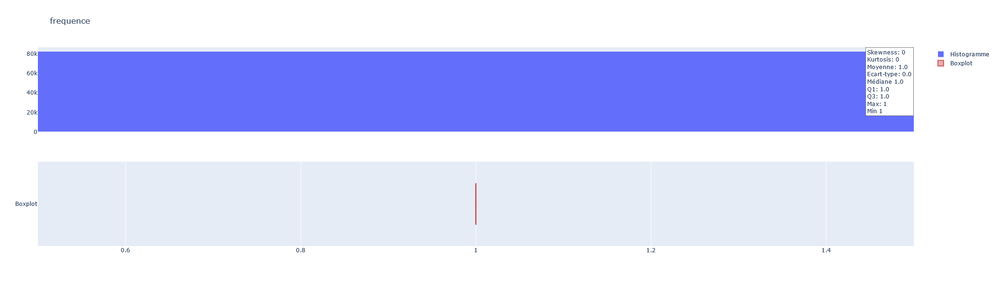

Nb de bins optimal estimé: 34


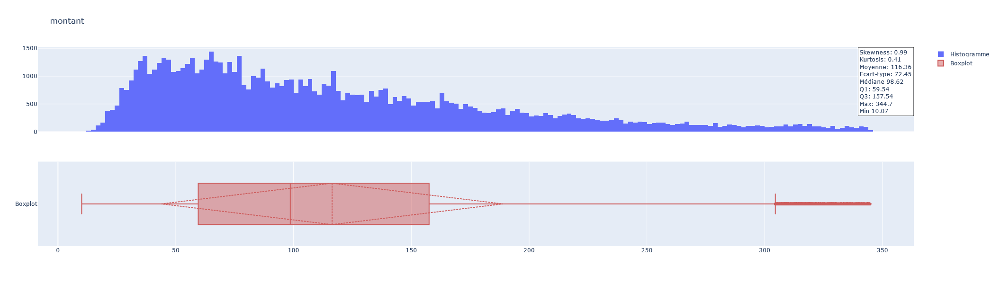

In [46]:
tmp = seg_a_df.copy()

for col in tmp.columns:
    tmp.drop(tmp[ex.mod_z(tmp[col]) > 3].index, axis='rows', inplace=True)
    
print(f'{seg_a_df.shape[0] - tmp.shape[0]} lignes éliminées.')

for col in tmp.columns:
    ex.mesure_forme_col(tmp[col], title=col)

<font color='red'> <b>Observations</b></font> <br>

- L'élimination par z-score nous permet de réduire la skewness de fréquence et montant de manière importante, cependant on perd environ 10% de notre dataset.
- La variance de notre variable fréquence est maintenant nulle.

### Preprocessing

In [55]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler

In [48]:
seg_a_df.drop('frequence', axis='columns', inplace=True) # On supprime la fréquence car elle n'a aucune variance

In [63]:
def preproc(df_original):

    # 1. Doublons
    df_cleaned = df_original.loc[df_original.index.drop_duplicates()]
    print(f'Suppression des doublons: {df_original.shape[0] - df_cleaned.shape[0]} commandes supprimées.')
    
    # 2. Eliminations d'infos non pertinentes
        # Faite avant sauvegarde de kpi.csv (restriction de la période d'etude)
    
    # Monoclient ?
    
    # 4. Outliers
    tmp_shape = df_cleaned.shape[0]

    # Suppression des outliers par Z-Score modifié
    for col in df_cleaned.columns:
        df_cleaned.drop(df_cleaned[ex.mod_z(df_cleaned[col]) > 3].index, axis='rows', inplace=True)

    print(f'Suppression des outliers par z-score modifié: {tmp_shape - df_cleaned.shape[0]}  clients supprimées.')
    
    # Gestion des NaNs
    tmp_shape = df_cleaned.shape[0]
    
    df_cleaned.dropna(inplace=True)
    print(f'Suppression des NaNs: {tmp_shape - df_cleaned.shape[0]} clients supprimées.')
    
    
    # Standardisation
    
    # Passer au log certaines variobles ?
    
    return df_cleaned

In [65]:
X_cleaned = preproc(seg_a_df)
X_train = X_cleaned.copy()

scaler = StandardScaler()
for col in X_train.columns:
    X_train[[col]] = scaler.fit_transform(X_train[[col]])

Suppression des doublons: 0 commandes supprimées.
Suppression des outliers par z-score modifié: 8119  clients supprimées.
Suppression des NaNs: 0 clients supprimées.


In [67]:
X_train.head()

,recence,montant
customer_unique_id,,
b1a1199364a4a7fe27c4486ab63f550d,-0.722645,-1.360329
4b86049cb99e4aa774031daa9cd18f18,-0.171078,2.067343
f63805d9c7edb84d92413af34b86a39c,-1.227695,-0.401040
619e926d09b26efbd5180368b1ddc874,-1.393830,0.072515
ad353b4fb0e294adc4eda48af73e68a6,-0.636255,-0.974371


### Sampling

Les calculs sur l'ensemble des données peuvent prendre du temps, je décide donc de sampler le dataset. <br>
Pour cela, je dois vérifier que: <br>
- Si un modèle est fit sur le sample il me donne les mêmes clusters que sur le dataset entier
- Que l'affirmation présente soit vérifiable peu importe le sample choisi

Pour vérifier cela, on va: <br>
- Entrainer le modèle sur tout le dataset (population) "model_pop"
- Entrainer le modele avec un nombre limités de lignes (100 à 50k) (échantillon) "model_samp"
- Prédire les labels pour chacun de ces modèles
- Calculer le ARI score du model_pop v model_samp

In [68]:
from sklearn.metrics import adjusted_rand_score
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
from sklearn.base import clone

In [69]:
from timeit import default_timer as timer

def sampling_with_ARI(model, df, size_samples, n_iter, stratify=None, debug=True):
    
    model_samp = clone(model)
    
    # Entrainement du modèle sur le dataset complet
    model_pop = model.fit(df)
    
    results = pd.DataFrame(columns=['taille_sample',  'mean_ari', 'std_ari', 'predict_time'])
    
    for sz_sample in size_samples:
        if debug: print(f'Taille du sample {sz_sample}: iteration ', end='')
            
        # J'entraine n_iter fois un modèle avec un échantillon de ma population aléatoire d'une taille sz_sample
        ari_sample = []
        predict_time = 0
        for i in range(n_iter):
            if debug: print(f'{i+1}....', end='')
            df_samp, _ = train_test_split(df, train_size=sz_sample, stratify=stratify) # On ne fixe pas random_state donc le choix va être aléatoire et différent à chaque itération
            
            start = timer()
            model_samp.fit(df_samp)
            
            predict_time += timer() - start
            true_labels = model_pop.predict(df_samp)
            ari = adjusted_rand_score(true_labels, model_samp.labels_)            
            ari_sample.append(ari)
        
        results = results.append(pd.DataFrame({'taille_sample':[sz_sample], 'mean_ari':[np.mean(ari_sample)], 'std_ari':[np.std(ari_sample)], 'predict_time':round(predict_time/n_iter, 3)}))
        if debug: print(f'Temps: {predict_time}')
    return results

In [75]:
size_samples = [100, 250, 500,
             750, 1000, 2000, 3000,
             4000, 5000, 7500, 10000, 20000, 50000]

results = sampling_with_ARI(KMeans(n_clusters=7, random_state=42), X_train, size_samples, 50, debug=True)
results

Taille du sample 100: iteration 1....2....3....4....5....6....7....8....9....10....11....12....13....14....15....16....17....18....19....20....21....22....23....24....25....26....27....28....29....30....31....32....33....34....35....36....37....38....39....40....41....42....43....44....45....46....47....48....49....50....Temps: 1.2464429999963613
Taille du sample 250: iteration 1....2....3....4....5....6....7....8....9....10....11....12....13....14....15....16....17....18....19....20....21....22....23....24....25....26....27....28....29....30....31....32....33....34....35....36....37....38....39....40....41....42....43....44....45....46....47....48....49....50....Temps: 1.8107809000011912
Taille du sample 500: iteration 1....2....3....4....5....6....7....8....9....10....11....12....13....14....15....16....17....18....19....20....21....22....23....24....25....26....27....28....29....30....31....32....33....34....35....36....37....38....39....40....41....42....43....44....45....46....47.

,taille_sample,mean_ari,std_ari,predict_time
0,100,0.626793,0.104384,0.025
0,250,0.693790,0.105969,0.036
0,500,0.748227,0.095110,0.052
0,750,0.758129,0.085036,0.062
0,1000,0.808385,0.084069,0.072
0,2000,0.851945,0.064888,0.102
0,3000,0.880004,0.046320,0.134
0,4000,0.888527,0.052963,0.150
0,5000,0.908849,0.041651,0.173
0,7500,0.914245,0.038903,0.218


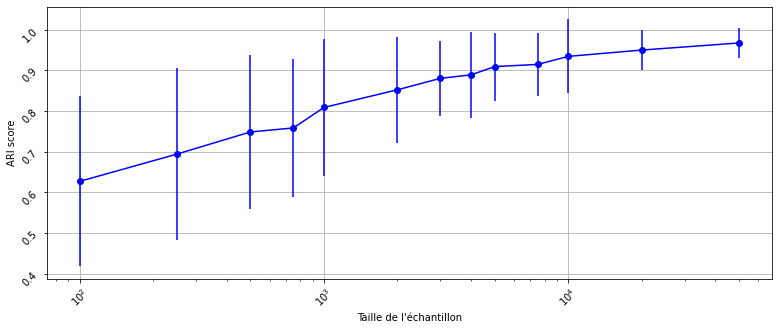

In [77]:
# Plotting the results
fig, ax = plt.subplots(1)
fig.set_size_inches(13,5)

ax.errorbar(results.taille_sample.values,
            results.mean_ari.values,
            yerr=2*(results.std_ari.values),
            marker='o', color='blue')

ax.tick_params(rotation=45)
ax.set_xscale('log')
plt.xlabel("Taille de l'échantillon")
plt.ylabel("ARI score")
plt.title(f"", fontweight='bold')
plt.grid()
plt.show()

**NB**: La bar d'erreur représente 2 fois l'écart type

Je choisis aléatoirement un 'groupe de clients' ayant comme paramètre l'ARI par rapport à la segmentation de ma population. <br>
Je cherche à estimer, en moyenne, quel est le score ARI. Je nomme theta mon estimateur. <br>

Pour cela je sélectionne 50 échantillons, et calcule la moyenne et l'écart-type ponctuel de ce groupe d'échantillon. <br>
N > 30 donc d'après le théorème central limite, on peut approcher la loi de theta par une loi normale. <br>

Pour 20k échantillons, on obtient une estimation de 0.95. <br>
**Il y a donc 95% de chance que mon score ARI soit compris dans l'intervalle I = [0.95 - 1.96 x 0.02 ; 0.95 + 1.96 x 0.02] = [0.91 ; 0.99]**

### Modélisation et évaluation 

In [80]:
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score

**Silhouette score (A maximiser)**: Measures the difference between the intra-cluster and nearest-cluster mean square distances <br>
**Calinski_Harabasz score (A maximiser)**: Dispersions inter-clusters / dispersion intra-clusters <br> 
**Davies_Bouldin score (A minimiser)**: Measures the maximal ratio of dispersion of pairs of clusters to their distance <br>
**Distortion (Trouver coude)**: Mean sum of squared distances to centers <br>

In [82]:
def compute_clust_scores_nclust(model, df, n_iter=10,
                                num_clusters=range(2,8), return_pop=False):
#### ATTENTION AU CAS PAR CAS POUR LES MODELES AUTRES QUE KMEANS

    dict_pop_perc_n_clust = {}
    dict_scores_iter = {}
    
    # --- Looping on the number of clusters to compute the scores
    for n_clust in num_clusters:

        silh, dav_bould, cal_harab, distor = [], [], [], []
        pop_perc_iter = pd.DataFrame()

        # Iterations of the same model (stability)
        for j in range(n_iter):
            model = KMeans(n_clusters=n_clust)
            model.fit(df)
            
            ser_clust = pd.Series(data=model.predict(df),
                                  index=df.index,
                                  name="iter_"+str(j))
            if return_pop:
                # Compute pct of clients in each cluster
                pop_perc = 100 * ser_clust.value_counts() / df.shape[0]
                pop_perc.sort_index(inplace=True)
                pop_perc.index = ['clust_'+str(i) for i in pop_perc.index]
                pop_perc_iter = pd.concat([pop_perc_iter, pop_perc.to_frame()],
                                          axis=1)
        
            # Computing scores for iterations
            silh.append(silhouette_score(X=df, labels=ser_clust))
            dav_bould.append(davies_bouldin_score(X=df, labels=ser_clust))
            cal_harab.append(calinski_harabasz_score(X=df, labels=ser_clust))
            distor.append(model.inertia_)

        if return_pop:
            # dict of the population (pct) of clusters iterations
             dict_pop_perc_n_clust[n_clust] = pop_perc_iter.T

        # Dataframe of the results on iterations
        scores_iter = pd.DataFrame({'Silhouette': silh,
                                    'Calinsky_Harabasz': cal_harab,
                                    'Davies_Bouldin': dav_bould,
                                    'Distortion': distor,
                                    })
        dict_scores_iter[n_clust] = scores_iter

    if return_pop:
        return dict_scores_iter, dict_pop_perc_n_clust
    else:
        return dict_scores_iter

    
def plot_scores_vs_n_clust(dict_scores_iter, figsize=(15,3)):
    ''' Plot the 4 mean scores stored in the dictionnary returned by the function
compute_clust_scores_nclust (dictionnary of dataframes of scores (columns)
for each iteration (rows) of the model and for each number of clusters
in a figure with error bars (2 sigmas)'''

    fig = plt.figure(figsize=figsize)
    list_n_clust = list(dict_scores_iter.keys())

    # Generic fonction to unpack dictionary and plot one graph
    def score_plot_vs_nb_clust(scores_iter, name, ax, c=None):
        score_mean = [dict_scores_iter[i].mean().loc[n_score] for i in list_n_clust]
        score_std = np.array([dict_scores_iter[i].std().loc[n_score]\
                            for i in list_n_clust])
        ax.errorbar(list_n_clust, score_mean, yerr=2*score_std, elinewidth=1,
                capsize=2, capthick=1, ecolor='k', fmt='-o', c=c, ms=5,
                barsabove=False, uplims=False)

    li_scores = ['Silhouette', 'Calinsky_Harabasz',
                   'Davies_Bouldin', 'Distortion']
    li_colors = ['r', 'b', 'purple', 'g']

    # Looping on the 4 scores
    i=0
    for n_score, c in zip(li_scores, li_colors):
        i+=1
        ax = fig.add_subplot(1,4,i)
        
        score_plot_vs_nb_clust(dict_scores_iter, n_score, ax, c=c)
        ax.set_xlabel('Number of clusters')
        ax.set_title(n_score+' score')

    fig.suptitle('Clustering score vs. number of clusters',
                fontsize=14, fontweight='bold')
    plt.tight_layout(rect=[0,0,1,0.95])
    plt.show()

In [83]:
%%time
sz_sample = 20000
X, _ = train_test_split(X_train, train_size=sz_sample)

scores = compute_clust_scores_nclust(KMeans(), X, n_iter=30, num_clusters=range(2,10))

Wall time: 17min 53s


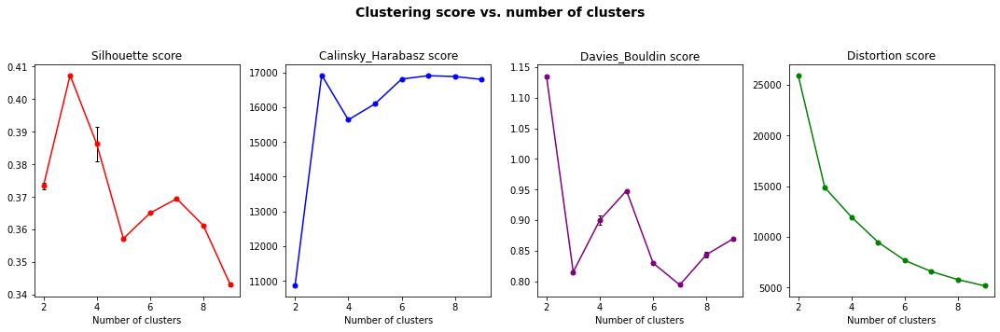

In [84]:
plot_scores_vs_n_clust(scores, figsize=(15,5))

De par ses résultats, le **nombre de clusters le plus adapté est 3 ou 7.**

### Analyse des clusters

On ré-entraine notre modèle sur le dataset entier puis on analyse les caractéristiques de chaque cluster.

In [86]:
%%time
model = KMeans(n_clusters=3, random_state=42)
model.fit(X_train)

Wall time: 414 ms


KMeans(n_clusters=3, random_state=42)

In [87]:
silh = silhouette_score(X=X_train, labels=model.labels_)
cal_harab = calinski_harabasz_score(X=X_train, labels=model.labels_)
dav_bould = davies_bouldin_score(X=X_train, labels=model.labels_)
distor = model.inertia_

print(f'Silhouette score {silh}')
print(f'Calinski-Harabasz  score {cal_harab}')
print(f'Davies-Bouldin  score {dav_bould}')
print(f'Distortion {distor}')

Silhouette score 0.4069213904106413
Calinski-Harabasz  score 71390.93514820986
Davies-Bouldin  score 0.8145230043214986
Distortion 63246.54283642524


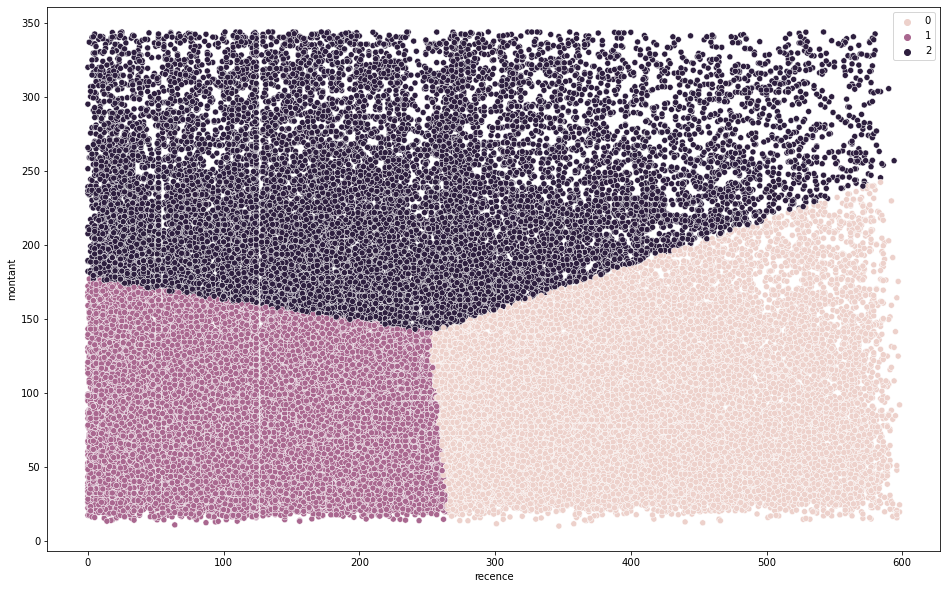

In [88]:
fig = plt.figure(figsize=(16,10))

sns.scatterplot(x=X_cleaned['recence'], y=X_cleaned['montant'], hue=model.labels_)

plt.show()

In [89]:
%%time
model = KMeans(n_clusters=7, random_state=42)
model.fit(X_train)

Wall time: 1.62 s


KMeans(n_clusters=7, random_state=42)

In [90]:
silh = silhouette_score(X=X_train, labels=model.labels_)
cal_harab = calinski_harabasz_score(X=X_train, labels=model.labels_)
dav_bould = davies_bouldin_score(X=X_train, labels=model.labels_)
distor = model.inertia_

print(f'Silhouette score {silh}')
print(f'Calinski-Harabasz  score {cal_harab}')
print(f'Davies-Bouldin  score {dav_bould}')
print(f'Distortion {distor}')

Silhouette score 0.3698096019892098
Calinski-Harabasz  score 72181.8519611403
Davies-Bouldin  score 0.7890143972679614
Distortion 27794.857578385418


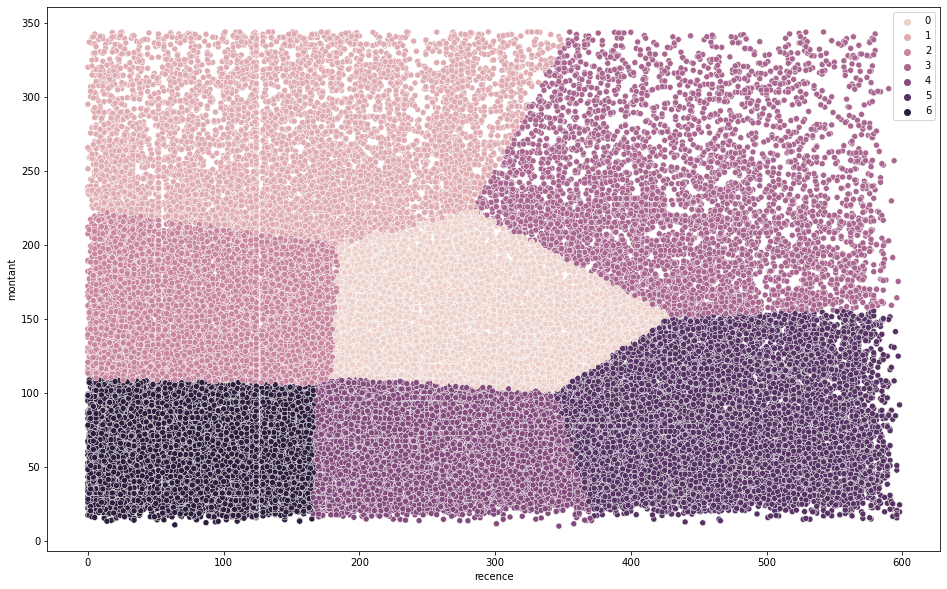

In [95]:
fig = plt.figure(figsize=(16,10))

sns.scatterplot(x=X_cleaned['recence'], y=X_cleaned['montant'], hue=model.labels_)

plt.show()

### Analyse de la stabilité des clusters

# Selection B: RFM + KPIs

Je cherche ici à ajouter des KPIs qui me permettront de séparer au mieux mes catégories de client. <br>
Pour cela je détermine 3 catégories de KPIs: <br>

- Geographique
    - Etat du client
- Fidélité (Une fois l'achat passé)
    - Nb de commentaires laissées
    - Moyenne des notes laissées
    - Nombre total de commandes passées
- Achat
    - Nombre moyen de produits par commandes
    - Prix moyen par commande
    - Mode de paiement
    - Catégories des produits
    - Montant par catégories

---

# Preprocessing

- Je normalise l'ensemble de mes variables textes
- Suppression des outliers (not delivered, restreindre la période d'étude)


    An order might have multiple items.
    Each item might be fulfilled by a distinct seller.
    All text identifying stores and partners where replaced by the names of Game of Thrones great houses.


# Feature Engineering

Segmentation
- Catégories des produits achetés
- Montant par catégorie

# Utils

https://nbviewer.jupyter.org/github/SmellyArmure/OC_DS_Project5/tree/master/NOTEBOOKS/ <br>

https://www.kaggle.com/kautumn06/yellowbrick-clustering-evaluation-examples <br>

https://python-visualization.github.io/folium/quickstart.html <br>

A mettre en avant sountenance:
- Très peu de clients commandent + d'une fois --> Peu de fidélisation
- 

Faire un RandomForest pour savoir quelles features ont le + d'importances